In [1]:
from matplotlib.image import imread # or `from imageio import imread`
from sklearn.cluster import KMeans
import numpy as np
import matplotlib.pyplot as plt
from numpy.linalg import svd

In [2]:
!ls

PCA_tSNE_UMAP.ipynb  one_pace.ipynb  onepiece.jpeg


In [3]:
img = imread('onepiece.jpeg')
img.shape

(1284, 1912, 3)

In [4]:
img

array([[[ 45,  89, 197],
        [ 62, 106, 202],
        [ 64, 108, 184],
        ...,
        [ 39, 104, 171],
        [ 37, 102, 166],
        [ 35, 100, 162]],

       [[ 50,  94, 202],
        [ 44,  87, 186],
        [ 56,  99, 180],
        ...,
        [ 39, 103, 173],
        [ 35,  99, 166],
        [ 32,  97, 162]],

       [[ 54,  98, 204],
        [ 48,  93, 194],
        [ 57, 104, 195],
        ...,
        [ 40, 106, 179],
        [ 49, 115, 186],
        [ 54, 120, 191]],

       ...,

       [[255, 244, 232],
        [252, 233, 221],
        [210, 178, 164],
        ...,
        [  4,   8,   9],
        [  4,   8,  11],
        [  3,   7,  10]],

       [[255, 251, 239],
        [255, 245, 232],
        [217, 187, 172],
        ...,
        [  3,   7,   8],
        [  0,   3,   6],
        [  0,   2,   5]],

       [[244, 235, 222],
        [250, 234, 221],
        [206, 177, 162],
        ...,
        [  0,   2,   3],
        [  3,   7,  10],
        [ 14,  18,  22]]

In [5]:
np.info(img)

class:  ndarray
shape:  (1284, 1912, 3)
strides:  (5736, 3, 1)
itemsize:  1
aligned:  True
contiguous:  True
fortran:  False
data pointer: 0x1c8fbbc0
byteorder:  little
byteswap:  False
type: uint8


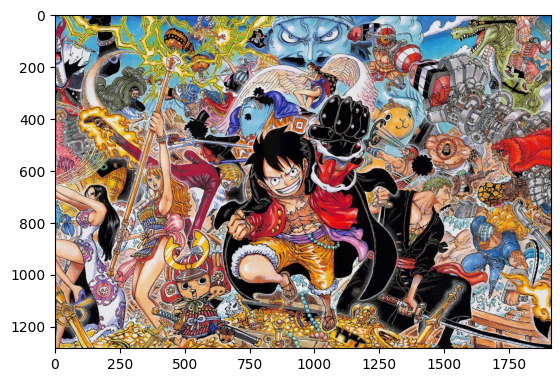

In [6]:
plt.imshow(img);
plt.show()

In [7]:
print(f"shape: {img.shape}")
print(f"dim: {img.ndim}")
print(f"size: {img.size}")
print("\n",img)

shape: (1284, 1912, 3)
dim: 3
size: 7365024

 [[[ 45  89 197]
  [ 62 106 202]
  [ 64 108 184]
  ...
  [ 39 104 171]
  [ 37 102 166]
  [ 35 100 162]]

 [[ 50  94 202]
  [ 44  87 186]
  [ 56  99 180]
  ...
  [ 39 103 173]
  [ 35  99 166]
  [ 32  97 162]]

 [[ 54  98 204]
  [ 48  93 194]
  [ 57 104 195]
  ...
  [ 40 106 179]
  [ 49 115 186]
  [ 54 120 191]]

 ...

 [[255 244 232]
  [252 233 221]
  [210 178 164]
  ...
  [  4   8   9]
  [  4   8  11]
  [  3   7  10]]

 [[255 251 239]
  [255 245 232]
  [217 187 172]
  ...
  [  3   7   8]
  [  0   3   6]
  [  0   2   5]]

 [[244 235 222]
  [250 234 221]
  [206 177 162]
  ...
  [  0   2   3]
  [  3   7  10]
  [ 14  18  22]]]


In [8]:
X = img.reshape(-1, 4)
print(f"shape: {X.shape}")
print(f"dim: {X.ndim}")
print(f"size: {X.size}")
print("\n",X)

shape: (1841256, 4)
dim: 2
size: 7365024

 [[ 45  89 197  62]
 [106 202  64 108]
 [184  74 117 164]
 ...
 [  3   7   8   0]
 [  2   3   3   7]
 [ 10  14  18  22]]


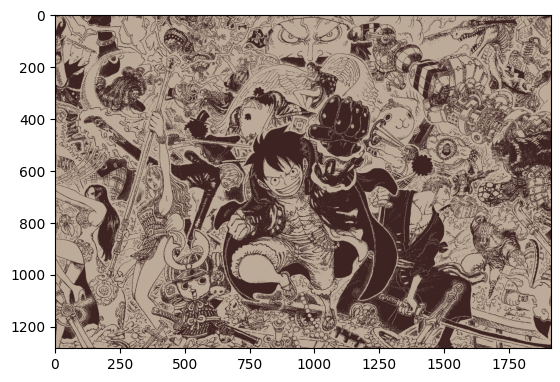

In [9]:

X = img.reshape(-1, 3)
kmeans = KMeans(n_clusters=2).fit(X)
segmented_img = kmeans.cluster_centers_[kmeans.labels_]
segmented_img = segmented_img.reshape(img.shape)


segmented_img = segmented_img/255.

plt.imshow(segmented_img);
plt.show()

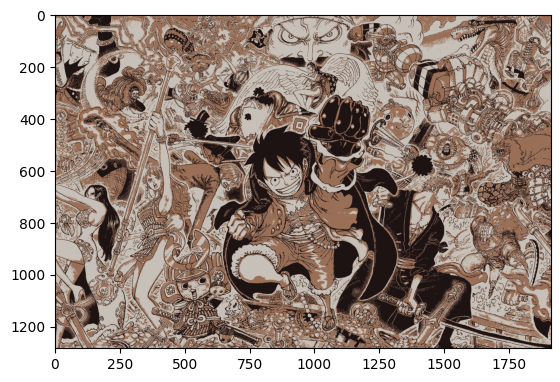

In [10]:
X = img.reshape(-1, 3)
kmeans = KMeans(n_clusters=3).fit(X)
segmented_img = kmeans.cluster_centers_[kmeans.labels_]
segmented_img = segmented_img.reshape(img.shape)


segmented_img = segmented_img/255.

plt.imshow(segmented_img);
plt.show()

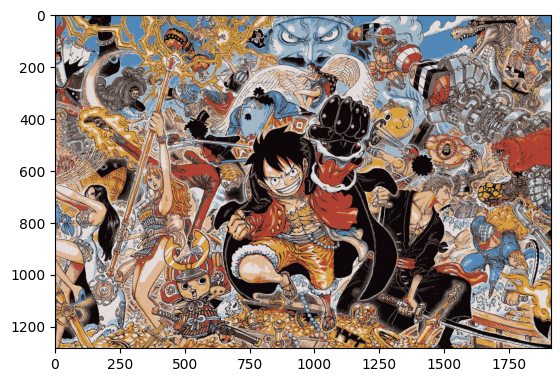

In [11]:
kmeans = KMeans(n_clusters=10,).fit(X)
segmented_img = kmeans.cluster_centers_[kmeans.labels_]
segmented_img = segmented_img.reshape(img.shape)

segmented_img = segmented_img/255.

plt.imshow(segmented_img);
plt.show()

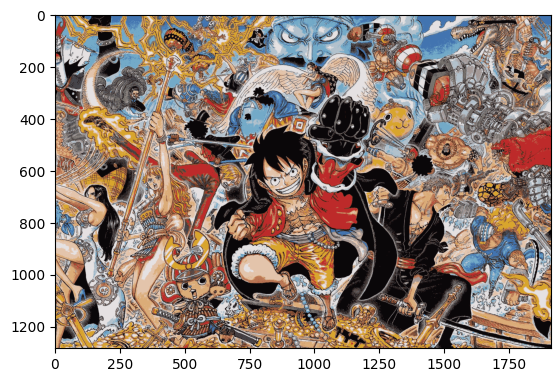

In [12]:
kmeans = KMeans(n_clusters=15,).fit(X)
segmented_img = kmeans.cluster_centers_[kmeans.labels_]
segmented_img = segmented_img.reshape(img.shape)

segmented_img = segmented_img/255.

plt.imshow(segmented_img);
plt.show()

In [13]:
img.shape

(1284, 1912, 3)

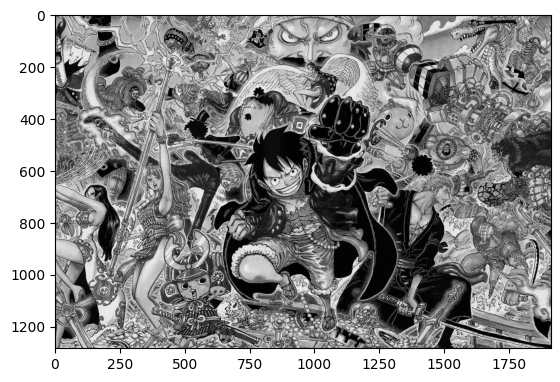

In [14]:
plt.imshow(img[:,:,1],cmap="gray"); 
plt.show()

In [15]:
U,S,VT = svd(img[:,:,1])

print(U.shape, S.shape, VT.shape)

S= np.diag(S)

(1284, 1284) (1284,) (1912, 1912)


In [16]:
import  pandas as pd

In [17]:
pd.DataFrame(
    [
        S.diagonal(),
        np.cumsum(S.diagonal()),
        (np.cumsum(S.diagonal()) / sum(S.diagonal()))*100
    ]).T.rename(columns={0:'eign value',1:'cumsum',2:'% of info'})

,eign value,cumsum,% of info
0,187850.557573,1.878506e+05,7.110473
1,30272.769789,2.181233e+05,8.256351
2,26663.793483,2.447871e+05,9.265622
3,24294.435405,2.690816e+05,10.185209
4,22654.075442,2.917356e+05,11.042706
...,...,...,...
1279,164.796506,2.641256e+06,99.976164
1280,163.197363,2.641419e+06,99.982341
1281,157.868099,2.641577e+06,99.988317
1282,157.080158,2.641734e+06,99.994262


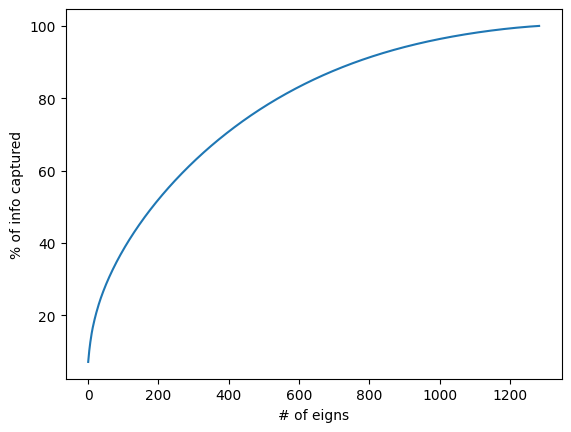

In [18]:
plt.plot( (np.cumsum(S.diagonal()) / sum(S.diagonal()))*100 )
plt.ylabel('% of info captured')
plt.xlabel('# of eigns')
plt.show()

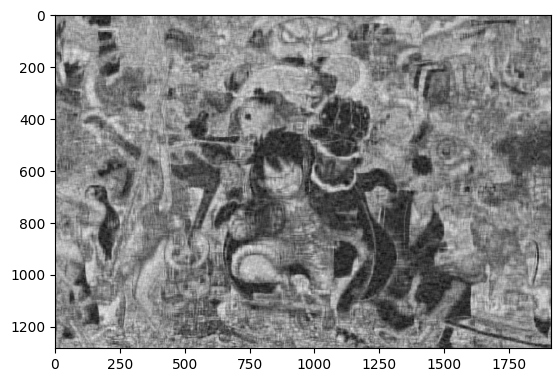

In [19]:
i=50
plt.imshow( U[:,:i] @ S[0:i,:i] @ VT[:i,:], cmap='gray' );
plt.show()

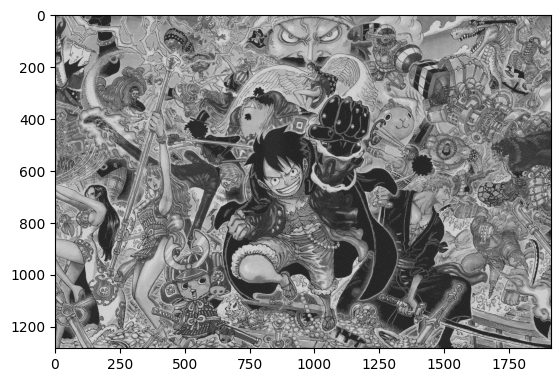

In [20]:
i=500
plt.imshow( U[:,:i] @ S[0:i,:i] @ VT[:i,:], cmap='gray' );
plt.show()

In [21]:
def cluster_run(num_of_k:int):
    kmeans = KMeans(n_clusters=num_of_k).fit(X)
    segmented_img = kmeans.cluster_centers_[kmeans.labels_]
    segmented_img = segmented_img.reshape(img.shape)


    segmented_img = segmented_img/255.

    plt.imshow(segmented_img);
    plt.show()

number of clusters: 1


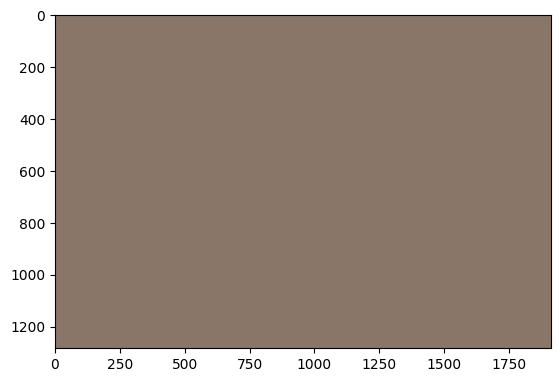

number of clusters: 2


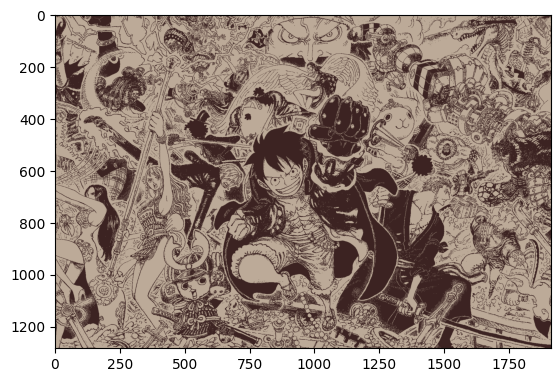

number of clusters: 3


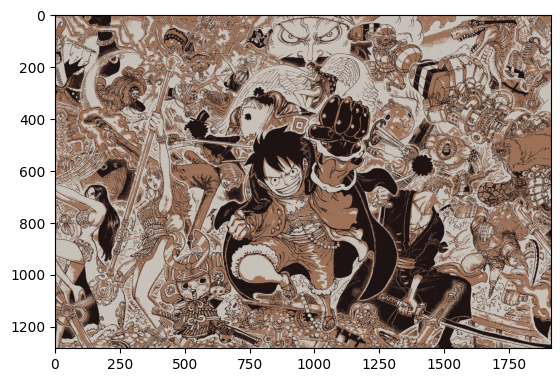

number of clusters: 4


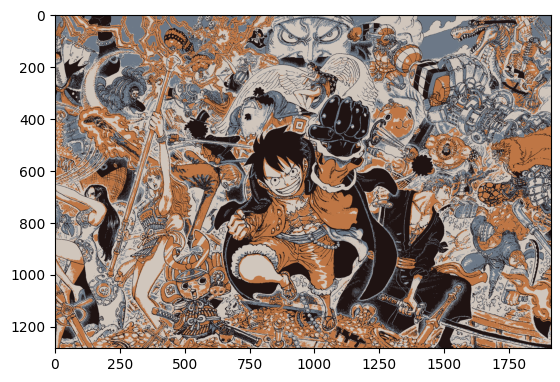

number of clusters: 5


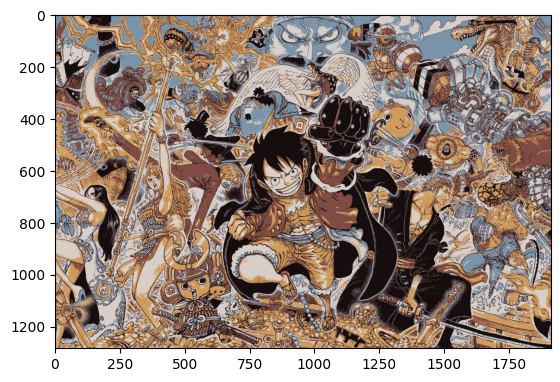

number of clusters: 6


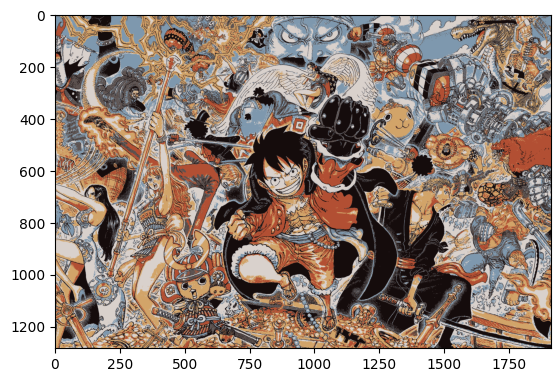

number of clusters: 7


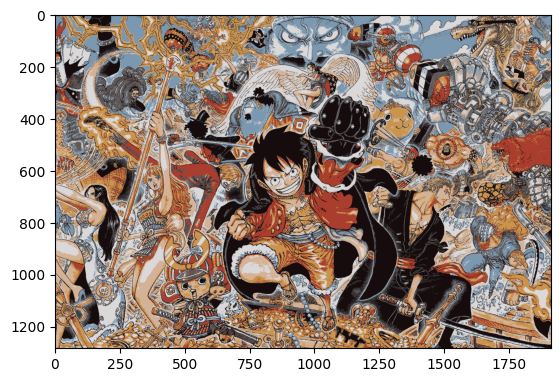

number of clusters: 8


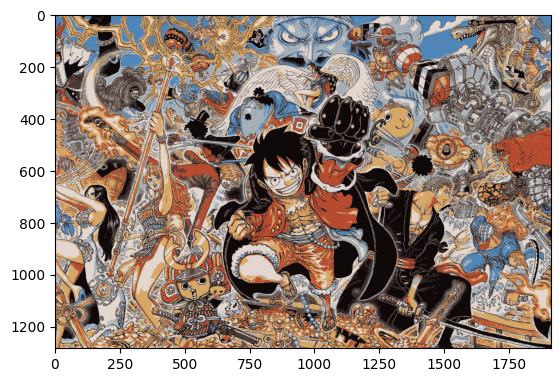

number of clusters: 9


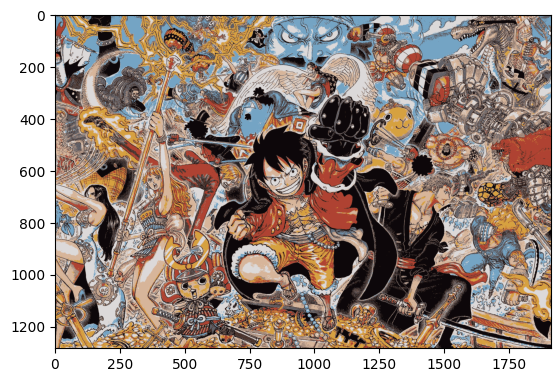

number of clusters: 10


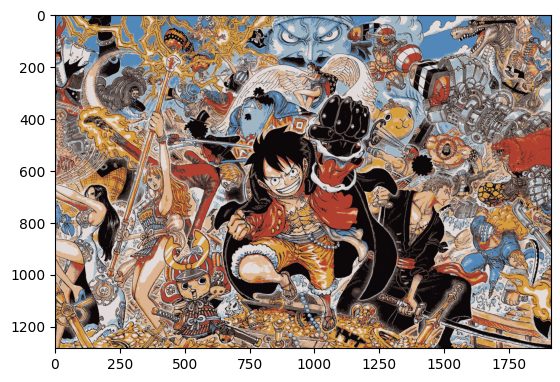

number of clusters: 11


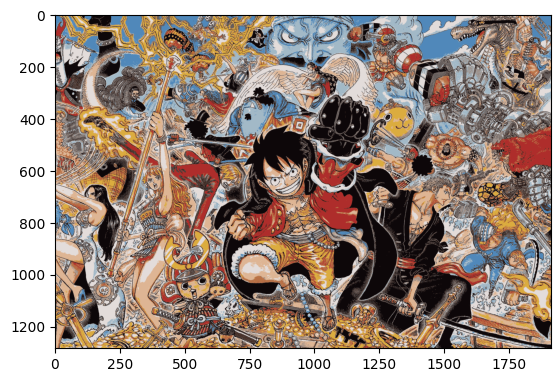

number of clusters: 12


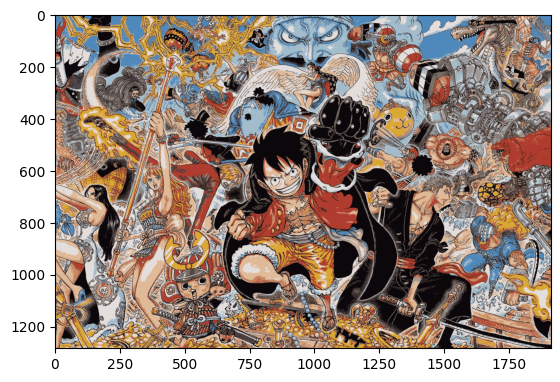

number of clusters: 13


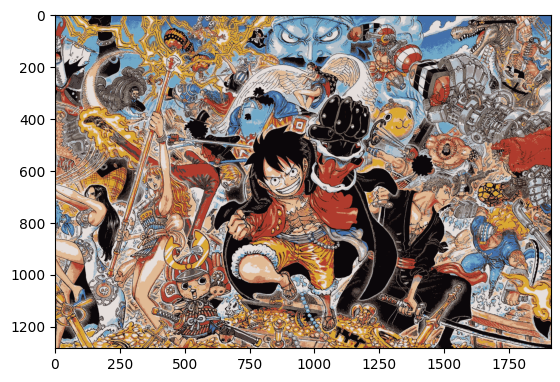

number of clusters: 14


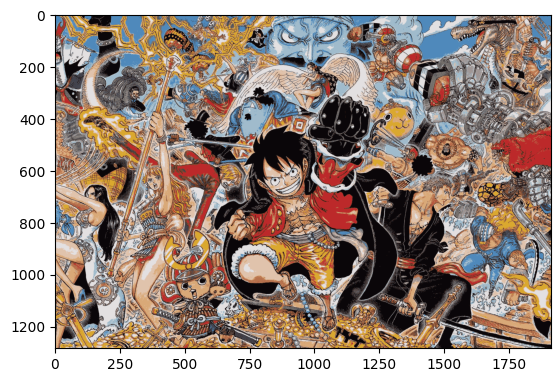

number of clusters: 15


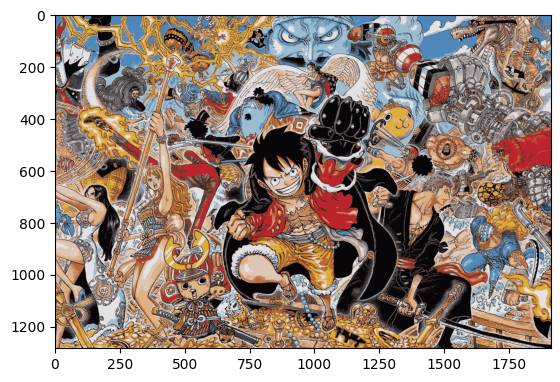

number of clusters: 16


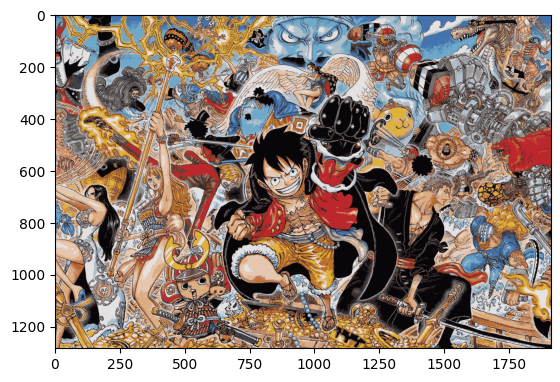

number of clusters: 17


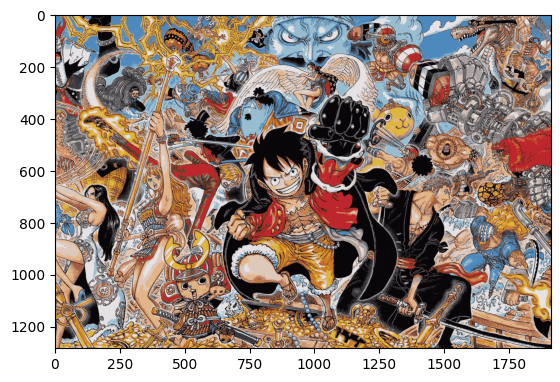

number of clusters: 18


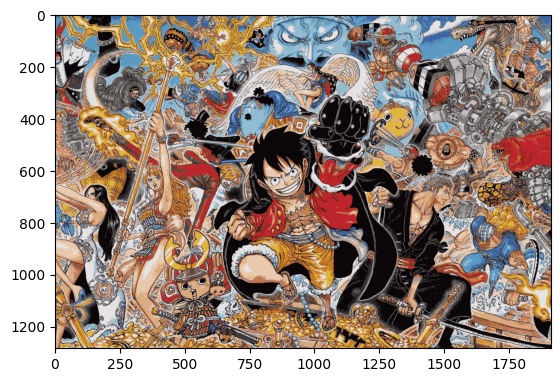

number of clusters: 19


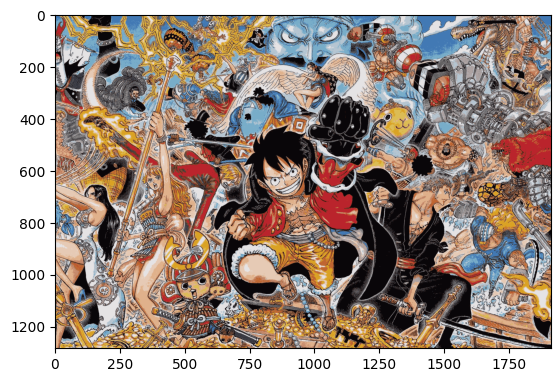

number of clusters: 20


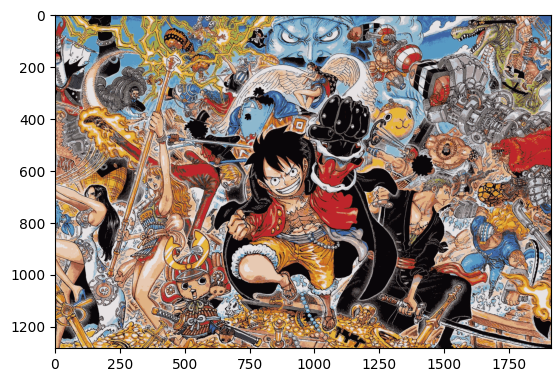

number of clusters: 21


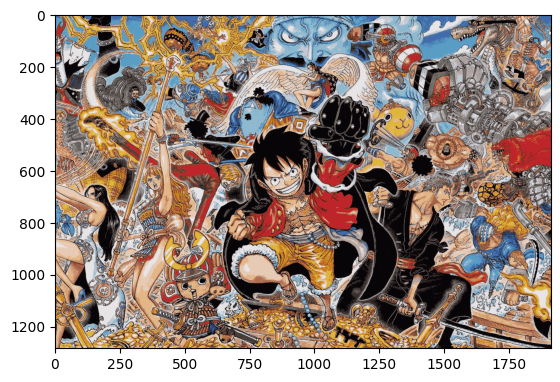

number of clusters: 22


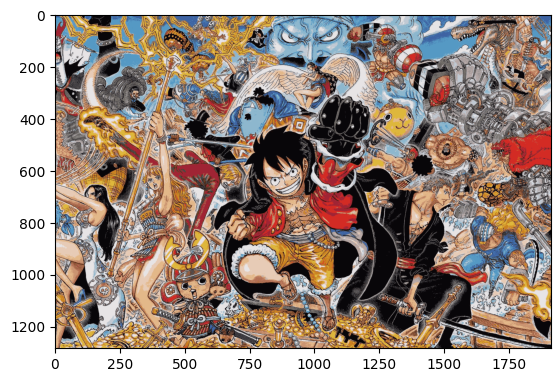

number of clusters: 23


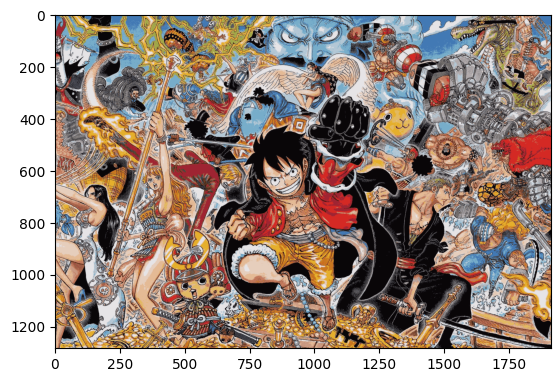

number of clusters: 24


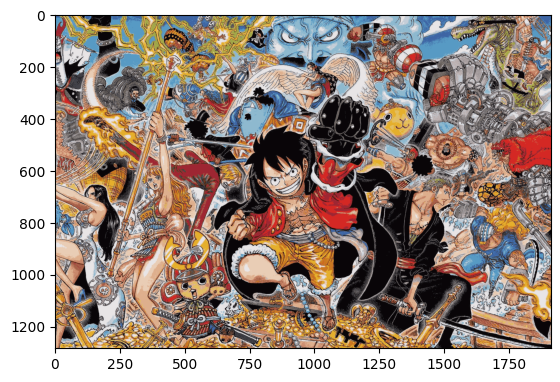

number of clusters: 25


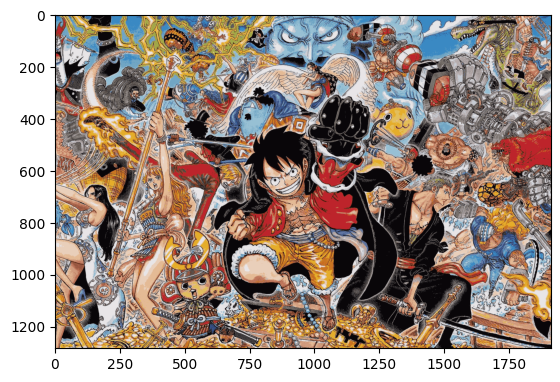

number of clusters: 26


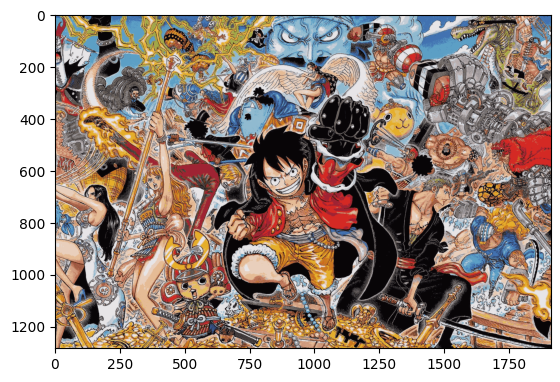

number of clusters: 27


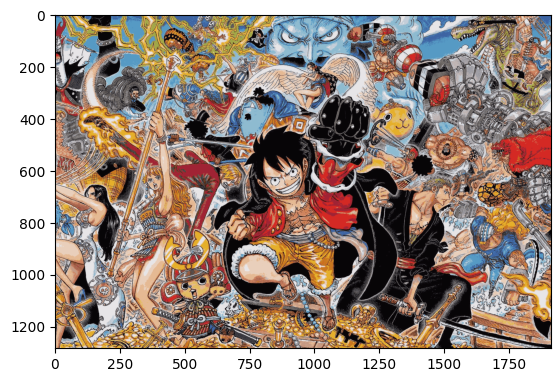

number of clusters: 28


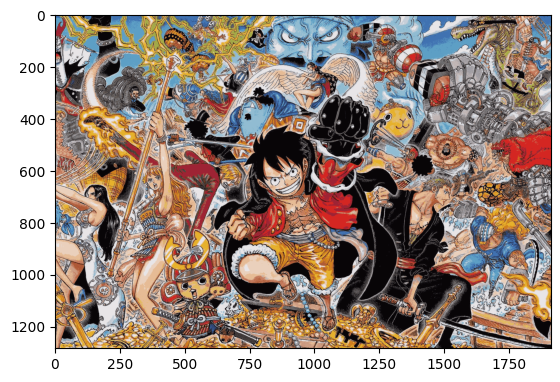

number of clusters: 29


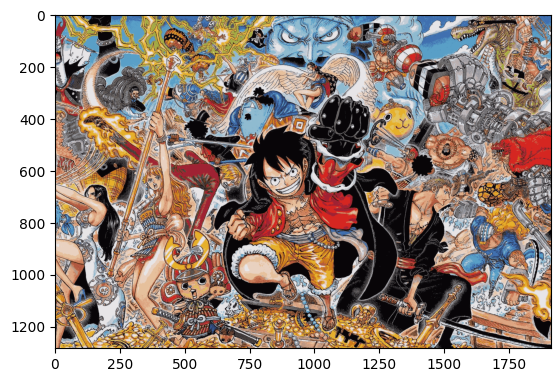

In [22]:
for k in range(1,30):
    print(f"number of clusters: {k}")
    cluster_run(k)

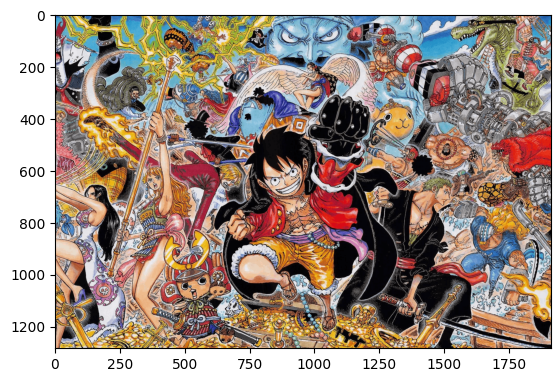

In [23]:
kmeans = KMeans(n_clusters=272).fit(X)
segmented_img = kmeans.cluster_centers_[kmeans.labels_]
segmented_img = segmented_img.reshape(img.shape)


segmented_img = segmented_img/255.

plt.imshow(segmented_img);
plt.show()